<a href="https://colab.research.google.com/github/dovkess/FGCVBreedDetection/blob/main/YOLODogs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Import cell. this is a cell run once to avoid having import problems later on.
%%capture
!pip install ultralytics
from ultralytics import YOLO
from PIL import Image
import io
import os
import sys
import pickle
import glob
import base64
import shutil

from google.colab import drive

# Assuming using colab, every time we run this we "compile" the helper functions from YOLO_funcs.
drive.mount('/content/drive')
name = 'YOLO_funcs'
new_name = 'yolo_funcs'
!jupyter nbconvert /content/drive/MyDrive/Colab_Notebooks/{name}.ipynb --to python
%rm /content/drive/MyDrive/Colab_Notebooks/{new_name}.py
%mv /content/drive/MyDrive/Colab_Notebooks/{name}.py /content/drive/MyDrive/Colab_Notebooks/{new_name}.py
sys.path.append('/content/drive/MyDrive/Colab_Notebooks/')
import yolo_funcs
import dog_funcs



In [ ]:
# get YOLO model
model = yolo_funcs.get_model()

In [ ]:
# Copy images to work with to the local machine
# Assuming we have the location in the drive...
aa = pickle.load(open('/content/drive/MyDrive/DogProject/oxford_ds/oxford_list_all.pkl', 'rb'))
dog_funcs.copy_images_by_list(aa, '/content/drive/MyDrive/DogProject/oxford_ds/images', local_loc='/oxford')

2026-01-22_11:04:23
2026-01-22_11:05:39


In [ ]:
# Iterate over the images and save cropped images.
paths = glob.glob('/content/oxford/**/*')
failed = []
for p in paths:
    new_path = p.replace('oxford', 'o_cropped')
    os.makedirs(os.path.dirname(new_path), exist_ok=True)
    ret = yolo_funcs.crop_and_save(model, p, new_path, dbg=False, crop_func=yolo_funcs.get_bounding_box_dogs_and_cats)
    if not ret:
        failed.append(p)
print(len(failed))


0


In [ ]:
# Full paths to the images
paths = glob.glob('/content/oxford/**/*')

Processing image: /content/oxford/samoyed/samoyed_58.jpg


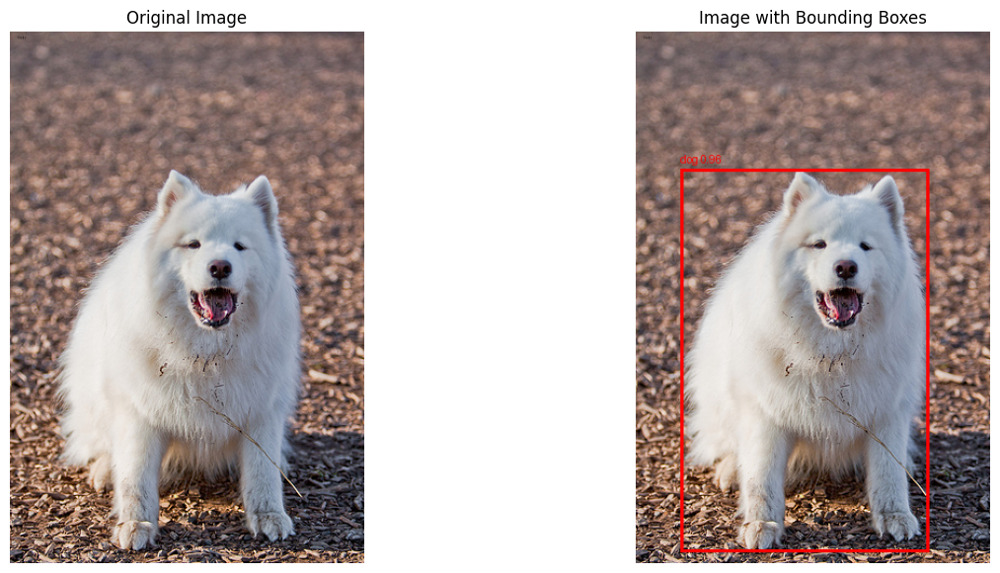

Processing image: /content/oxford/great_pyrenees/great_pyrenees_139.jpg


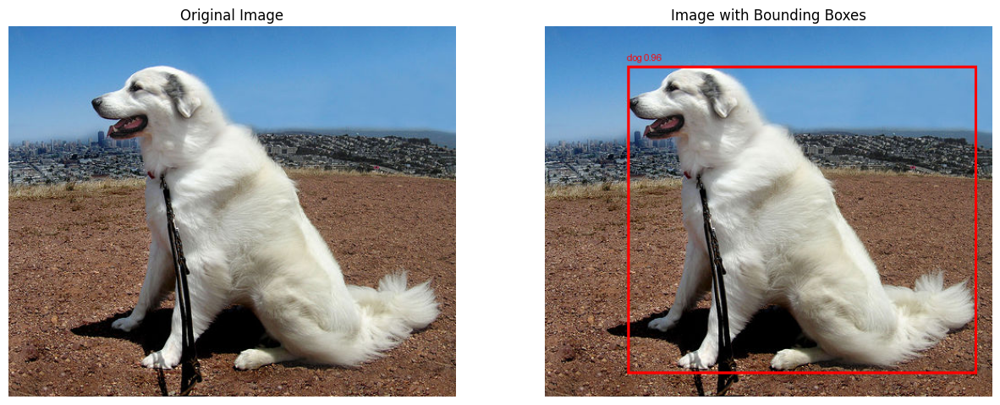

Processing image: /content/oxford/Maine_Coon/Maine_Coon_126.jpg


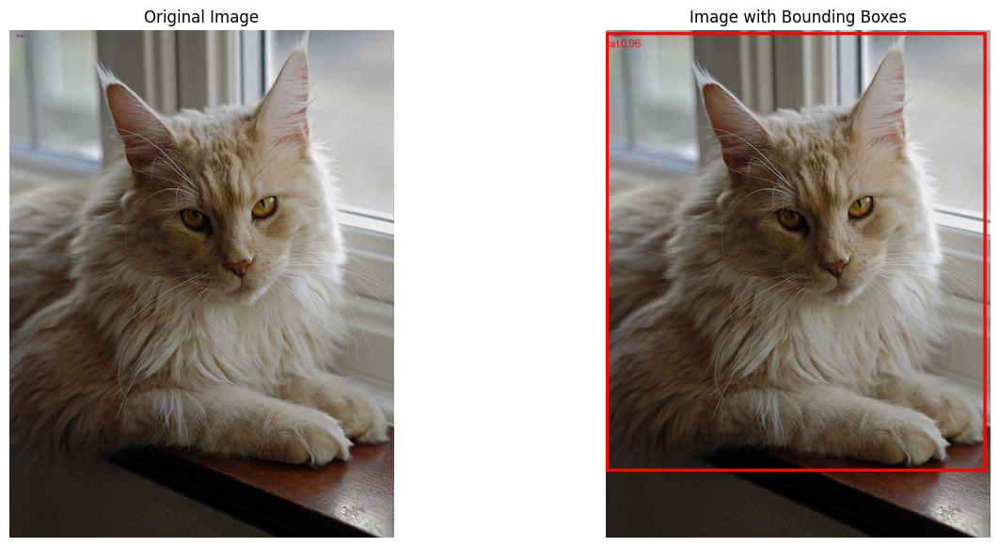

Processing image: /content/oxford/leonberger/leonberger_43.jpg


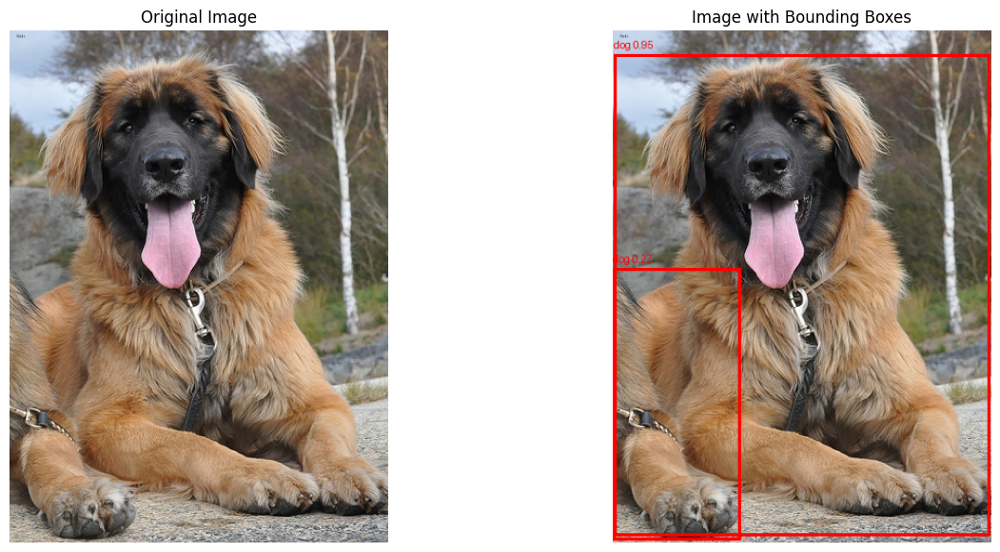

Processing image: /content/oxford/chihuahua/chihuahua_127.jpg


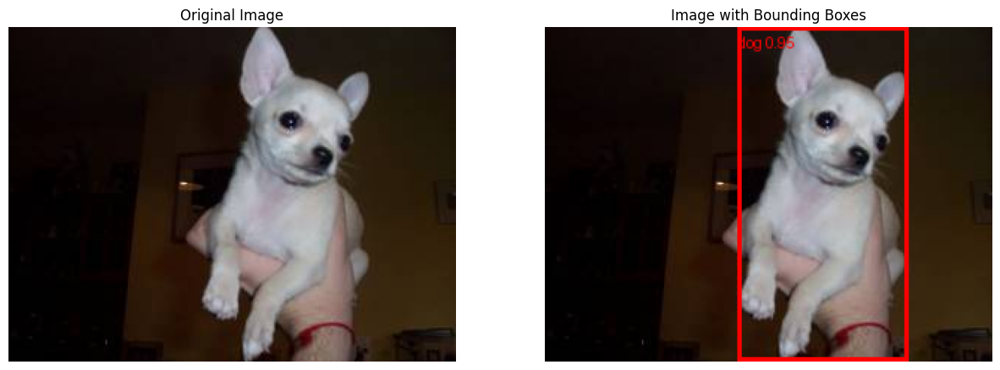

Processing image: /content/oxford/boxer/boxer_2.jpg


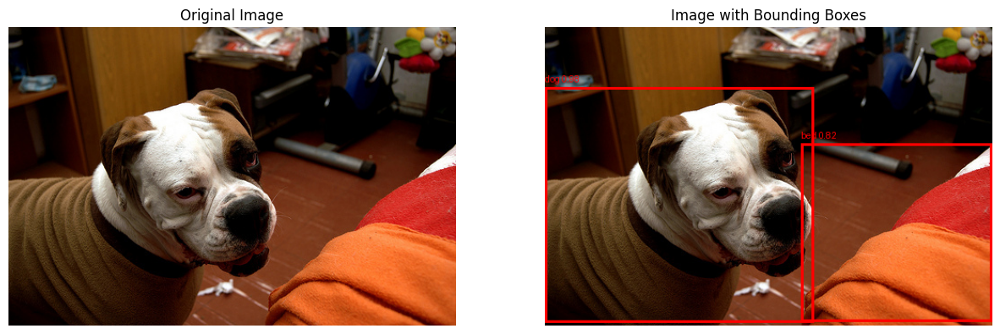

Processing image: /content/oxford/american_bulldog/american_bulldog_55.jpg


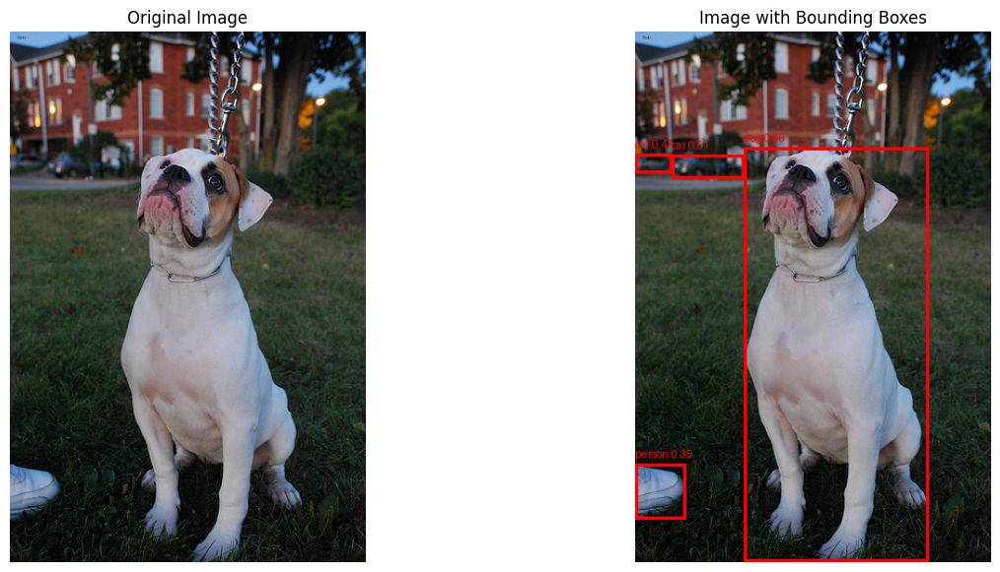

Processing image: /content/oxford/British_Shorthair/British_Shorthair_97.jpg


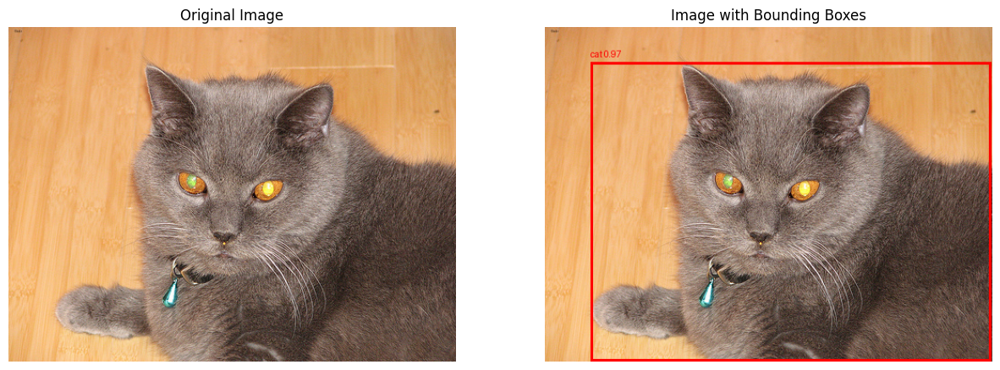

Processing image: /content/oxford/samoyed/samoyed_96.jpg


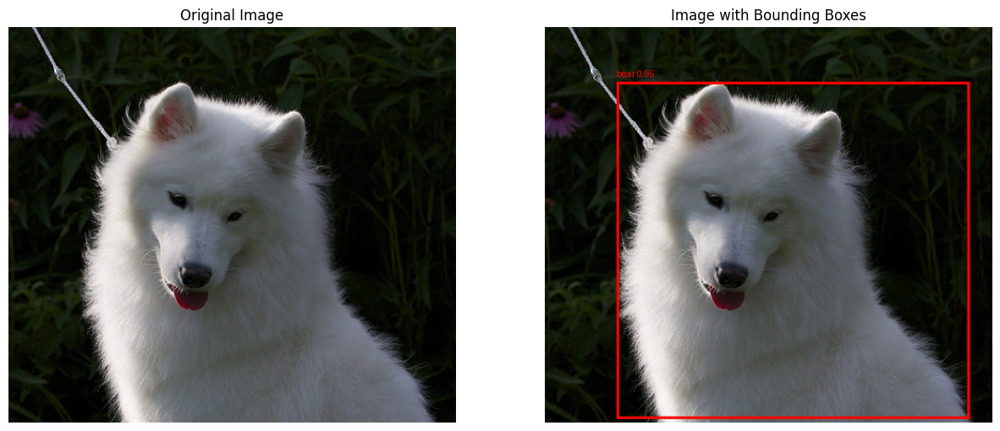

Processing image: /content/oxford/Ragdoll/Ragdoll_72.jpg


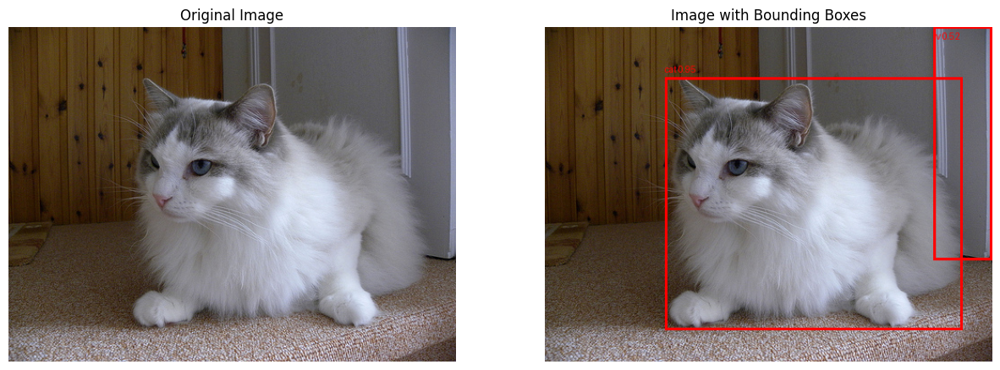

Processing image: /content/oxford/saint_bernard/saint_bernard_164.jpg


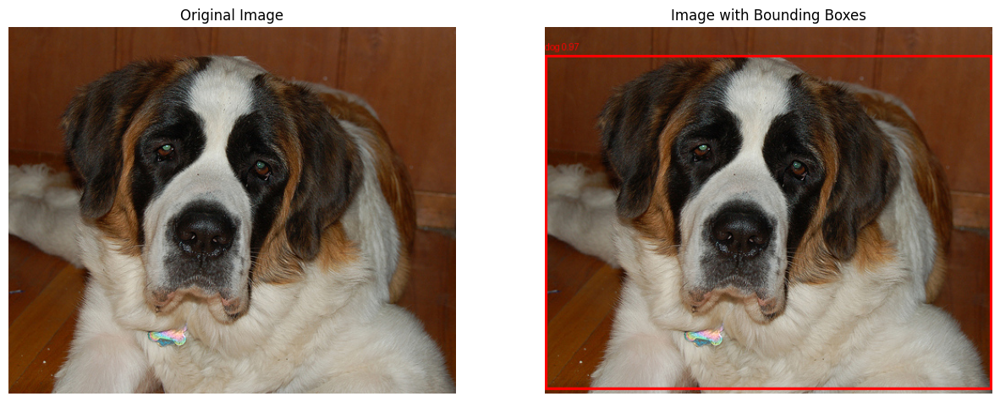

Processing image: /content/oxford/english_setter/english_setter_153.jpg


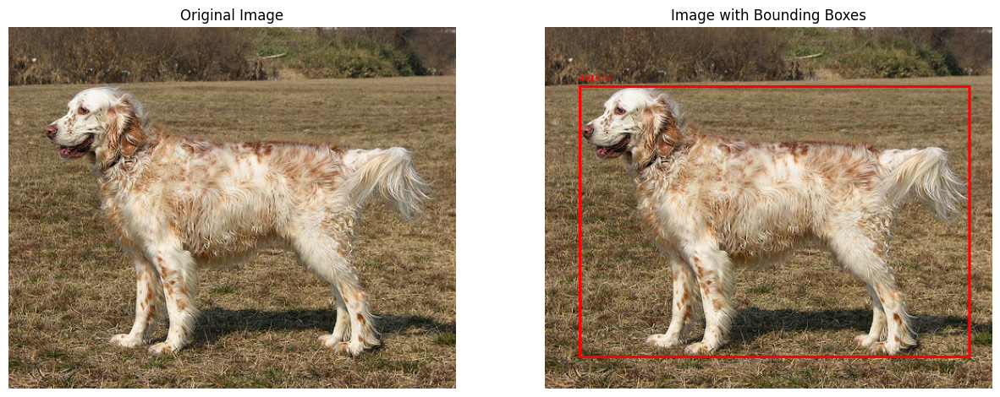

Processing image: /content/oxford/shiba_inu/shiba_inu_110.jpg


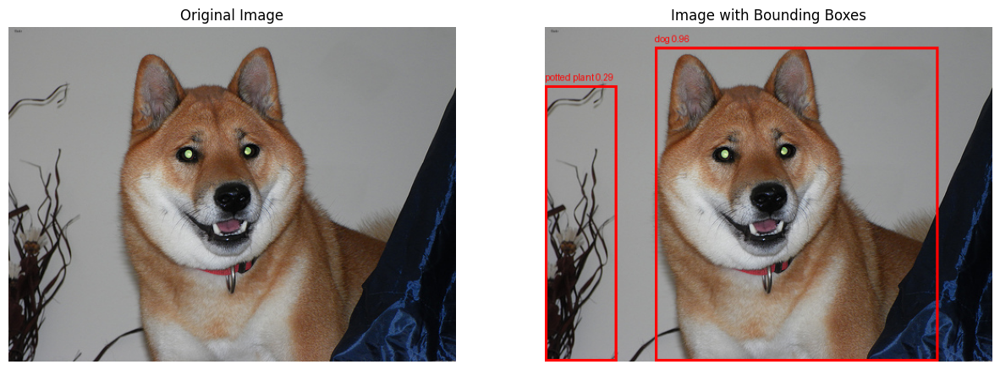

Processing image: /content/oxford/Birman/Birman_35.jpg


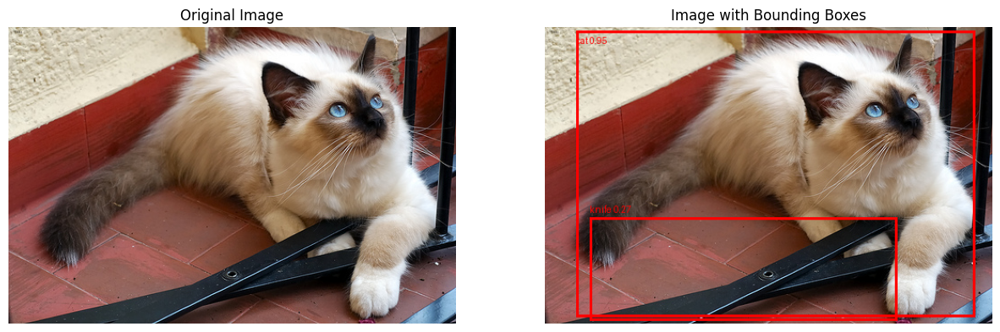

Processing image: /content/oxford/Ragdoll/Ragdoll_74.jpg


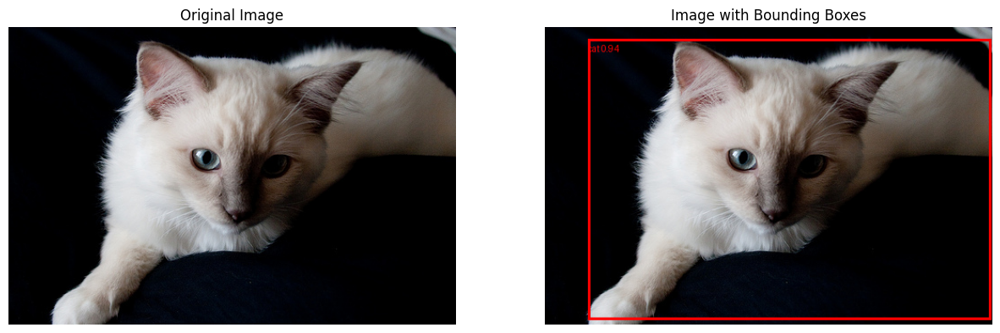

Processing image: /content/oxford/leonberger/leonberger_46.jpg


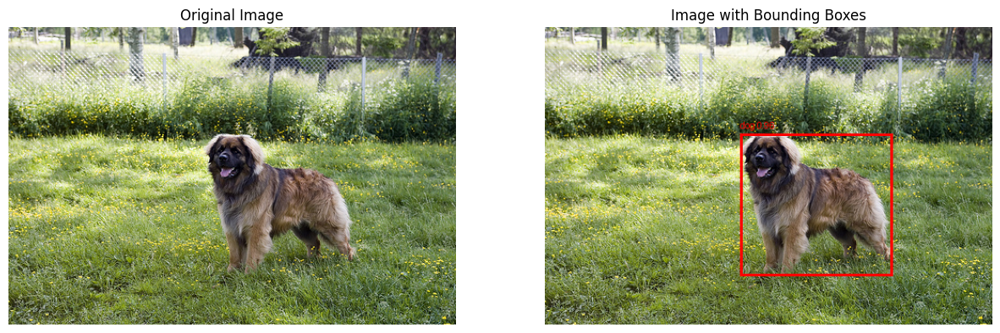

Processing image: /content/oxford/boxer/boxer_107.jpg


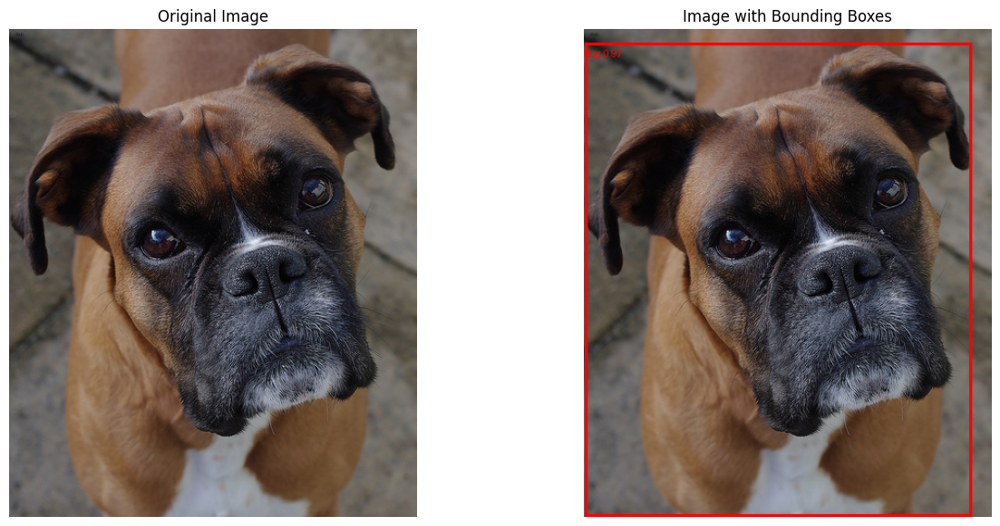

Processing image: /content/oxford/Sphynx/Sphynx_73.jpg


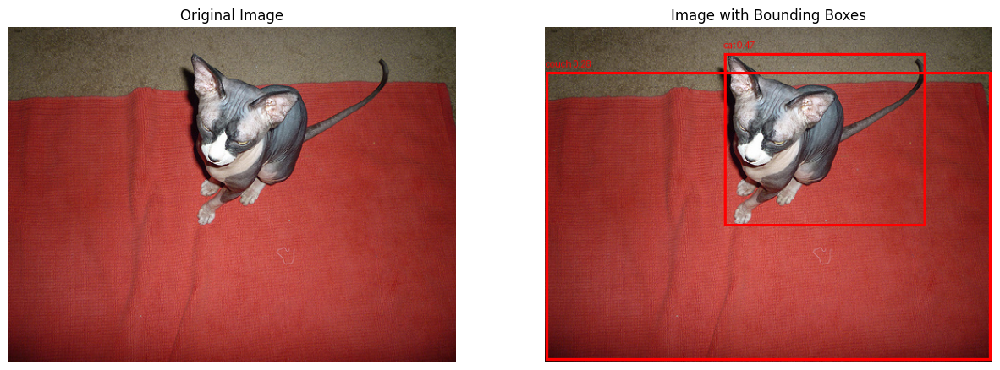

Processing image: /content/oxford/miniature_pinscher/miniature_pinscher_126.jpg


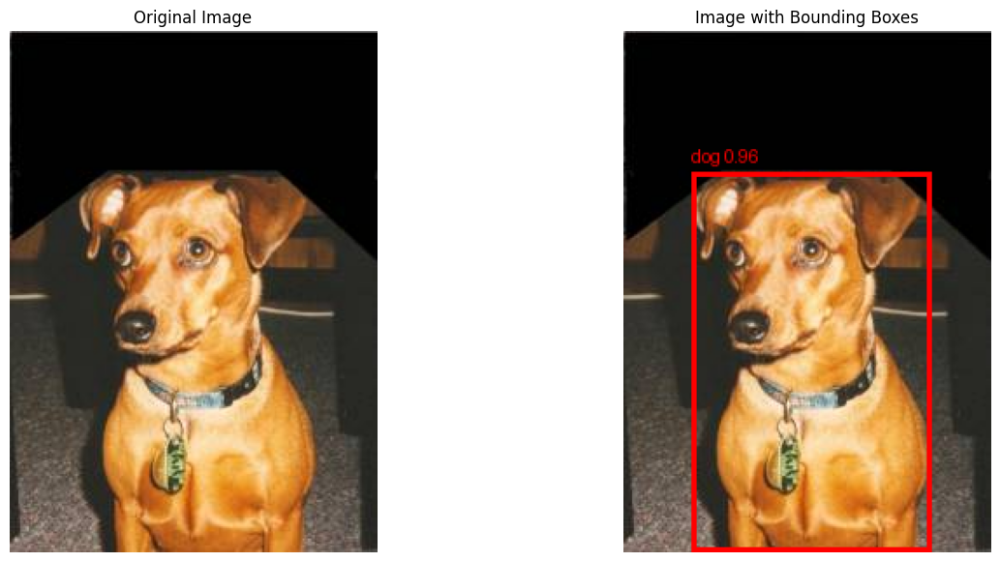

Processing image: /content/oxford/chihuahua/chihuahua_23.jpg


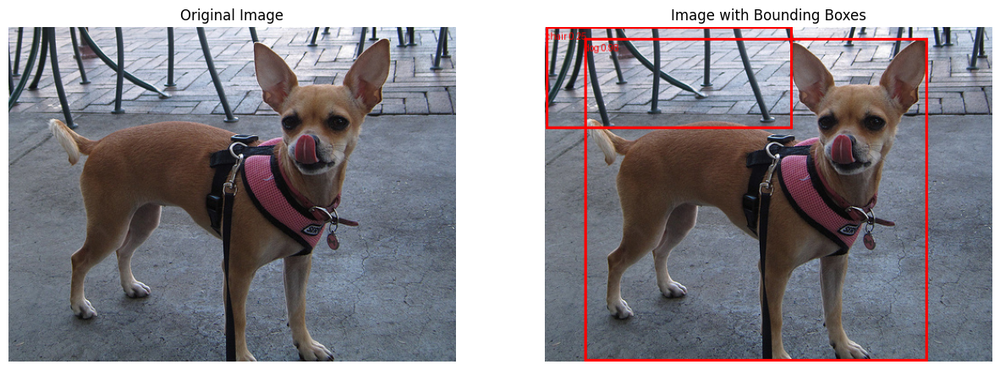

Processing image: /content/oxford/japanese_chin/japanese_chin_77.jpg


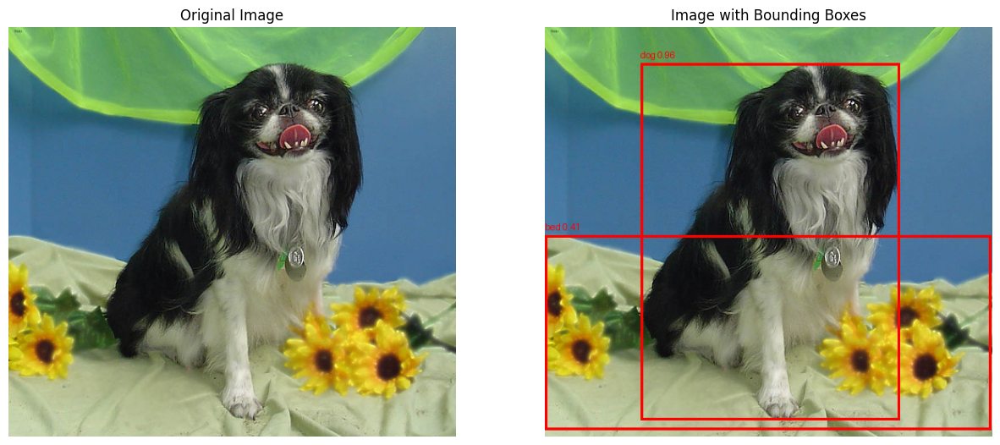

Processing image: /content/oxford/Ragdoll/Ragdoll_83.jpg


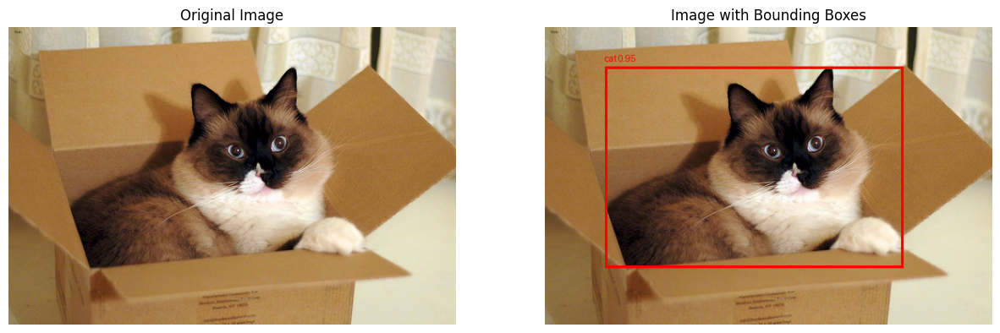

Processing image: /content/oxford/Maine_Coon/Maine_Coon_78.jpg


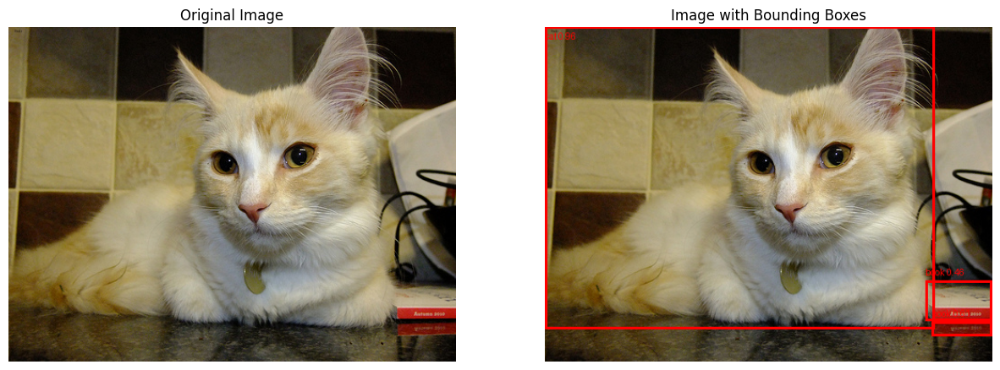

Processing image: /content/oxford/leonberger/leonberger_199.jpg


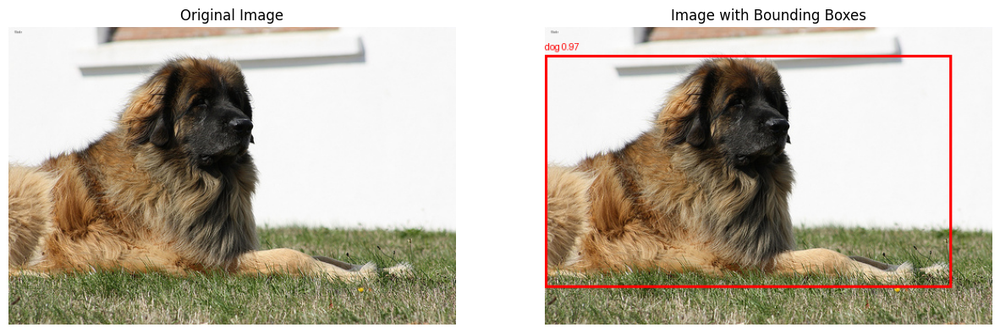

Processing image: /content/oxford/english_cocker_spaniel/english_cocker_spaniel_107.jpg


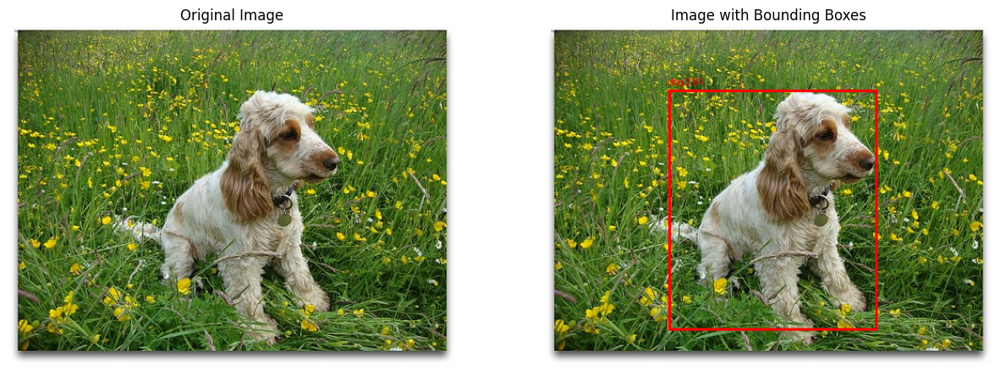

Processing image: /content/oxford/great_pyrenees/great_pyrenees_124.jpg


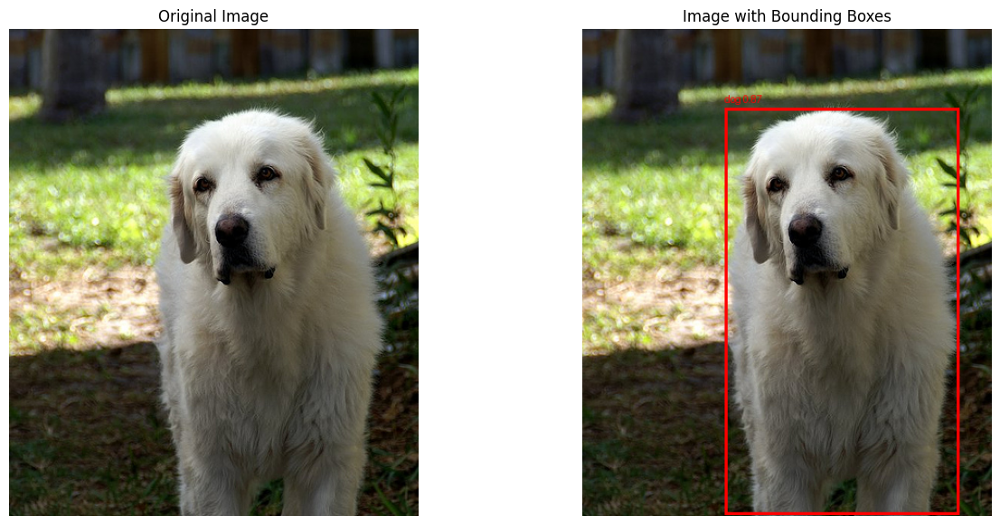

Processing image: /content/oxford/havanese/havanese_190.jpg


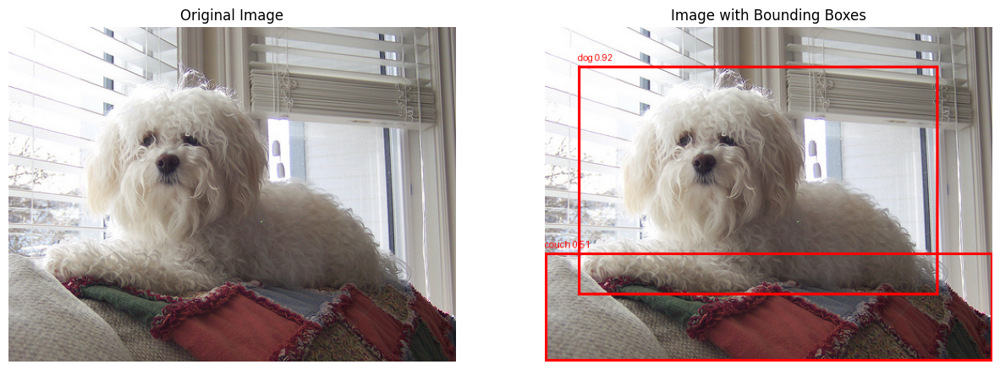

Processing image: /content/oxford/Egyptian_Mau/Egyptian_Mau_151.jpg


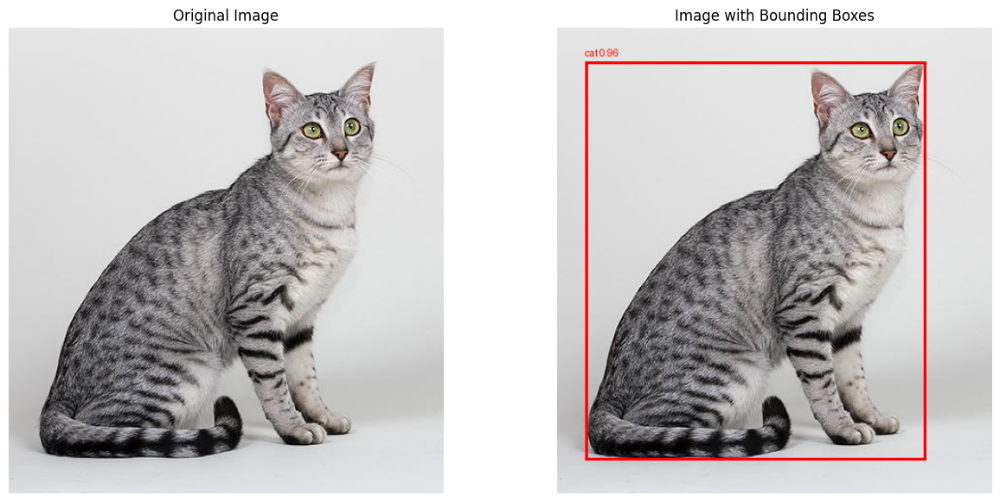

Processing image: /content/oxford/Maine_Coon/Maine_Coon_128.jpg


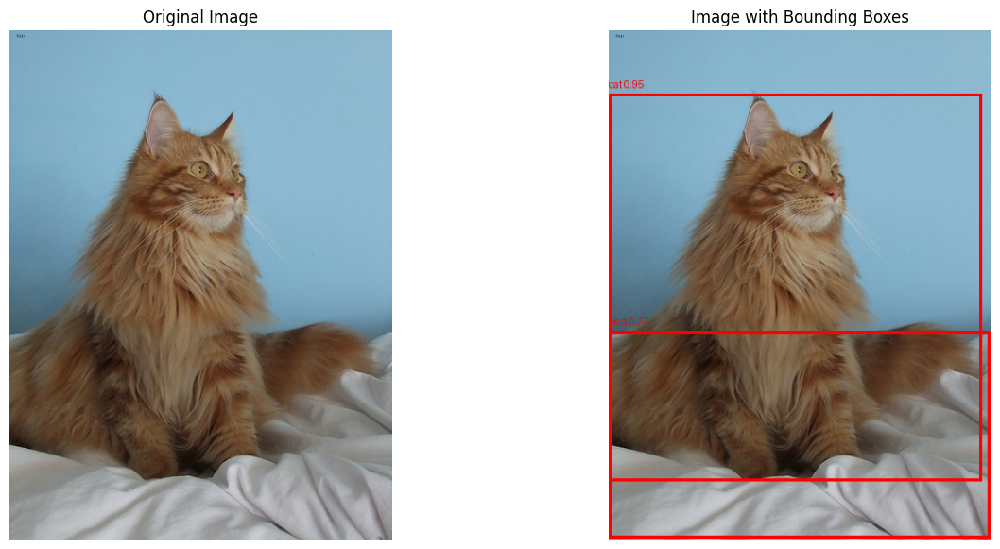

Processing image: /content/oxford/Russian_Blue/Russian_Blue_158.jpg


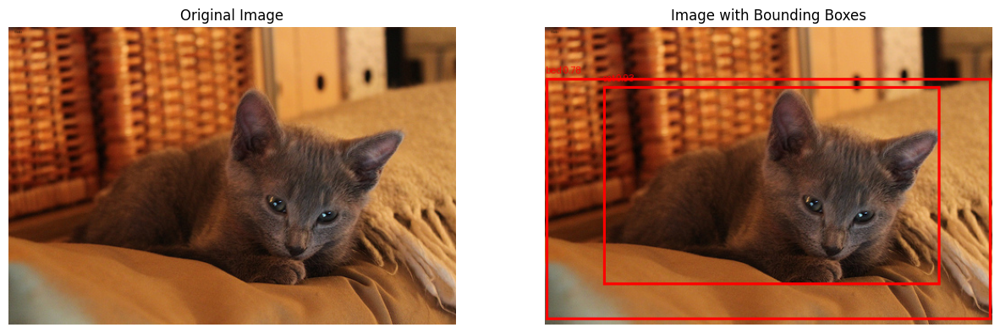

Processing image: /content/oxford/english_setter/english_setter_52.jpg


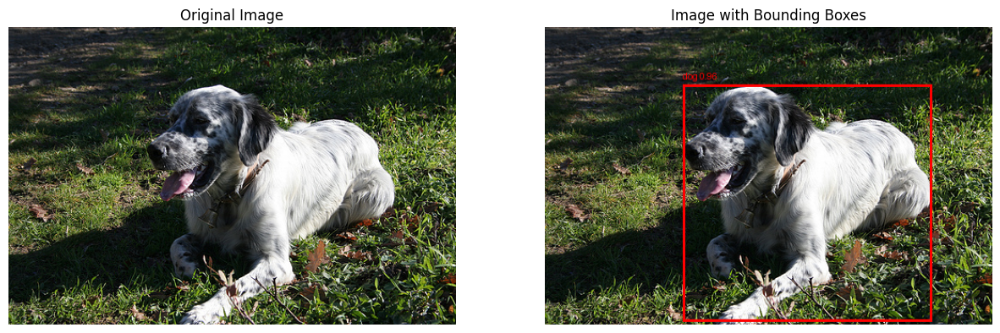

Processing image: /content/oxford/Egyptian_Mau/Egyptian_Mau_102.jpg


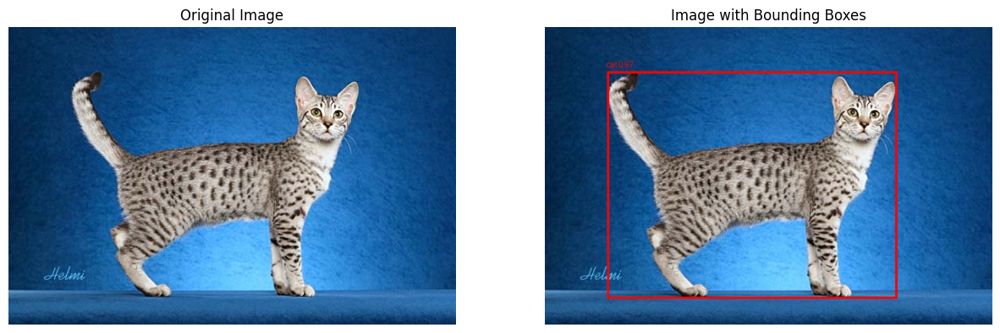

Processing image: /content/oxford/japanese_chin/japanese_chin_32.jpg


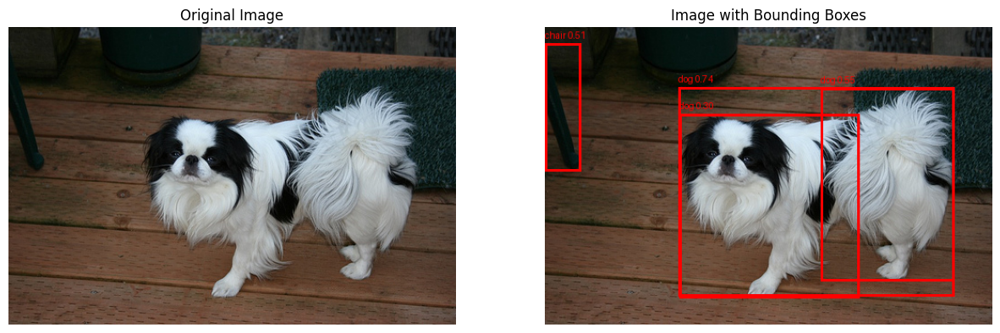

Processing image: /content/oxford/american_pit_bull_terrier/american_pit_bull_terrier_126.jpg


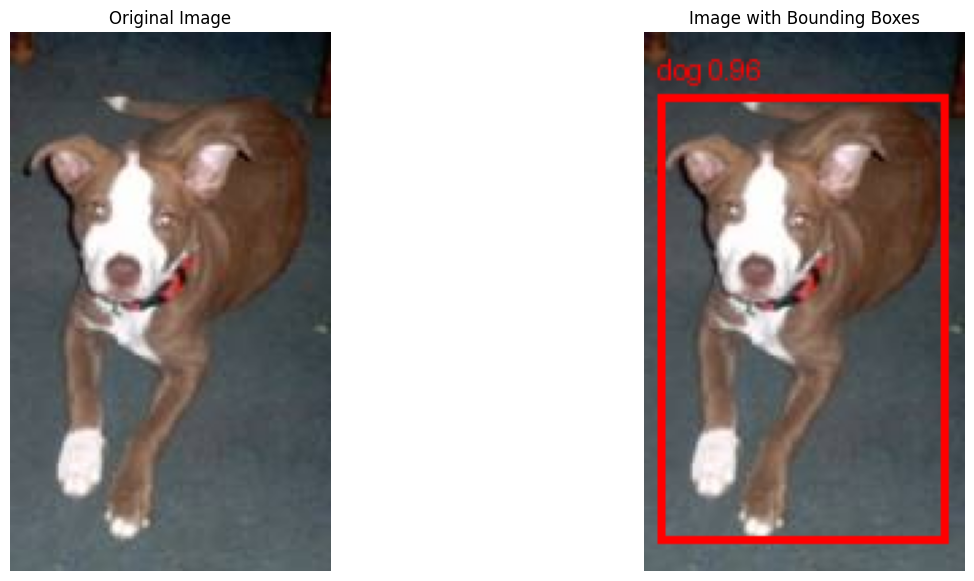

Processing image: /content/oxford/yorkshire_terrier/yorkshire_terrier_69.jpg


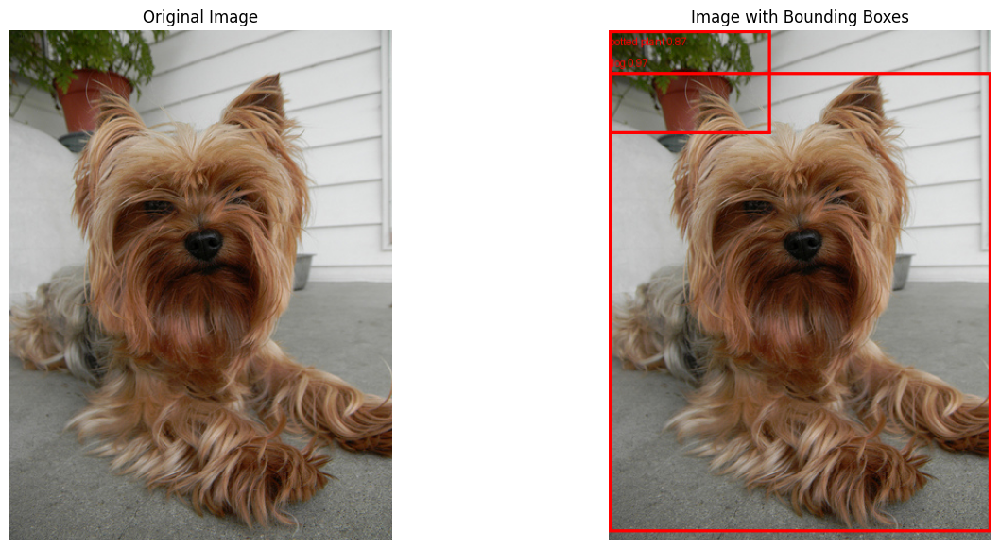

Processing image: /content/oxford/Bombay/Bombay_41.jpg


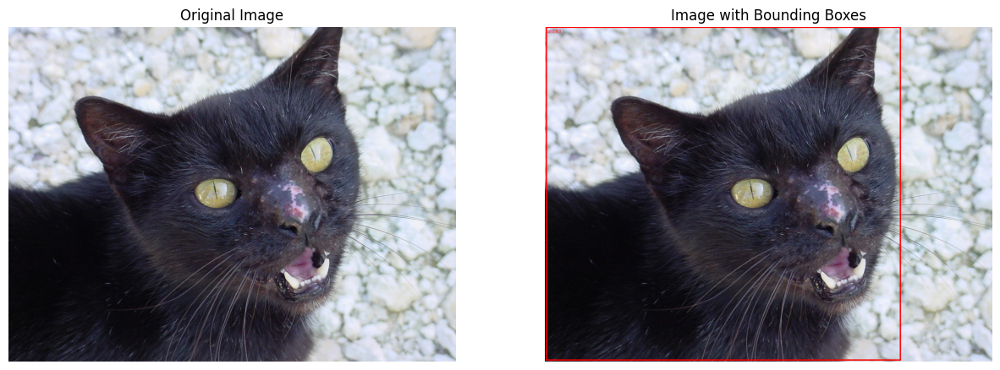

Processing image: /content/oxford/german_shorthaired/german_shorthaired_88.jpg


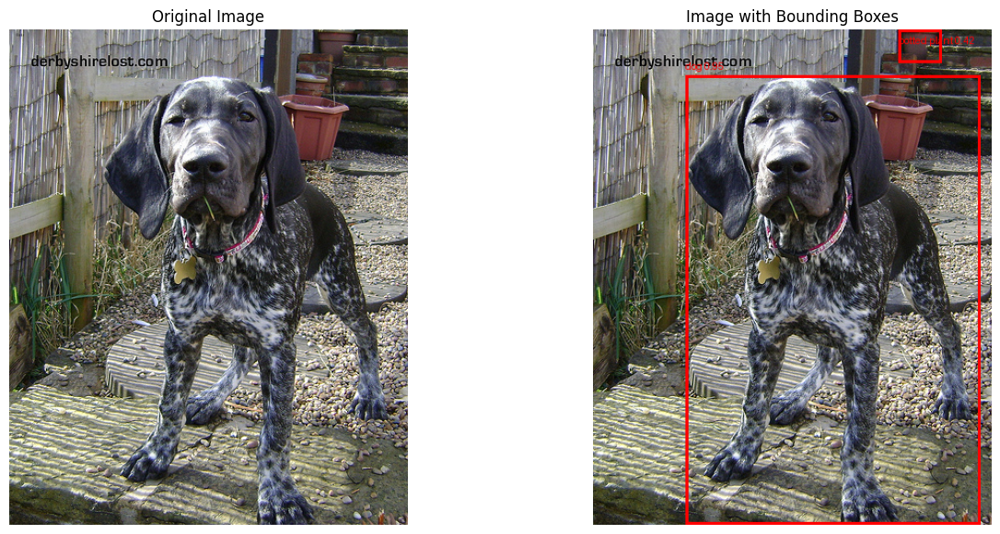

Processing image: /content/oxford/Persian/Persian_27.jpg


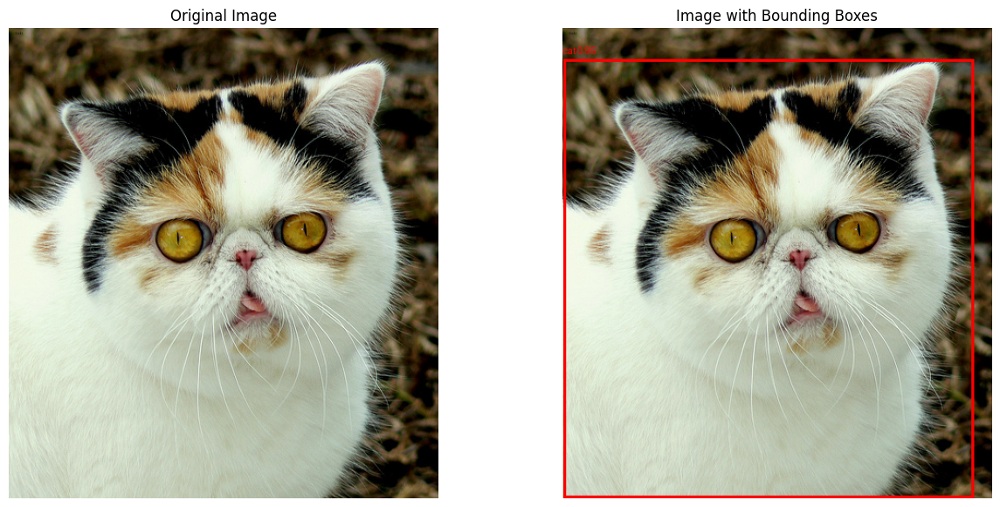

Processing image: /content/oxford/wheaten_terrier/wheaten_terrier_157.jpg


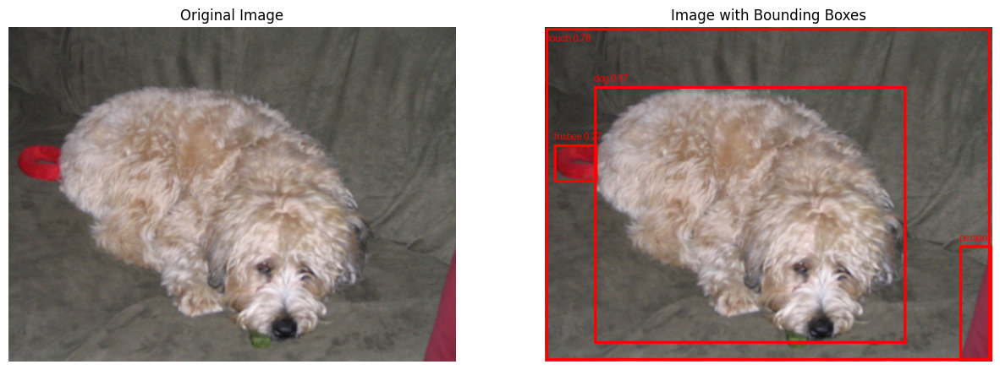

Processing image: /content/oxford/german_shorthaired/german_shorthaired_178.jpg


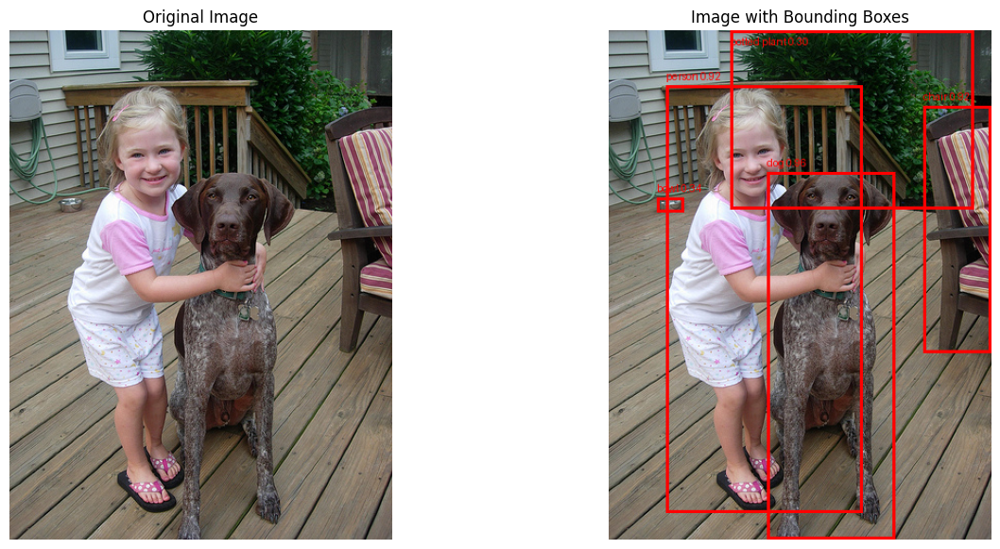

Processing image: /content/oxford/shiba_inu/shiba_inu_35.jpg


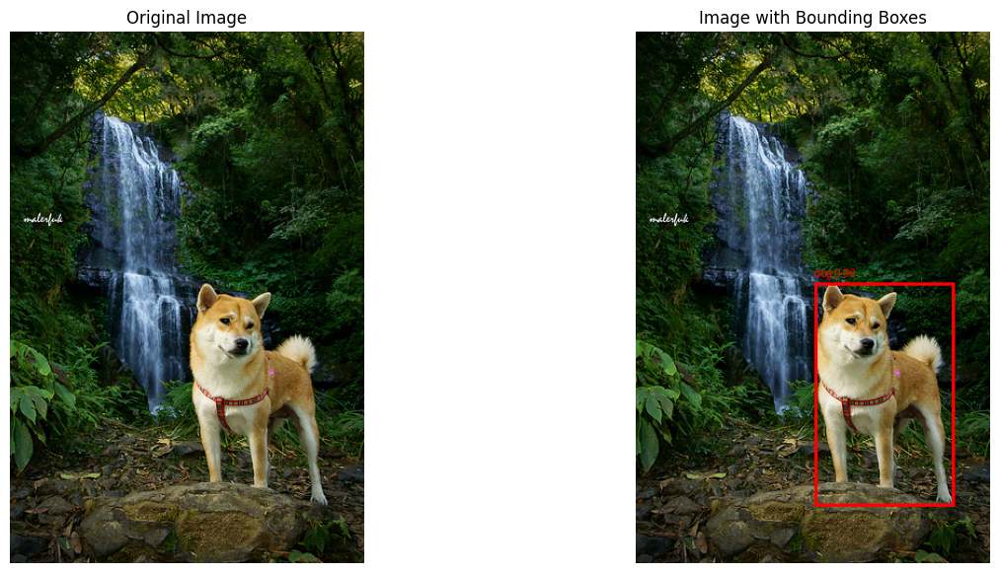

Processing image: /content/oxford/pomeranian/pomeranian_78.jpg


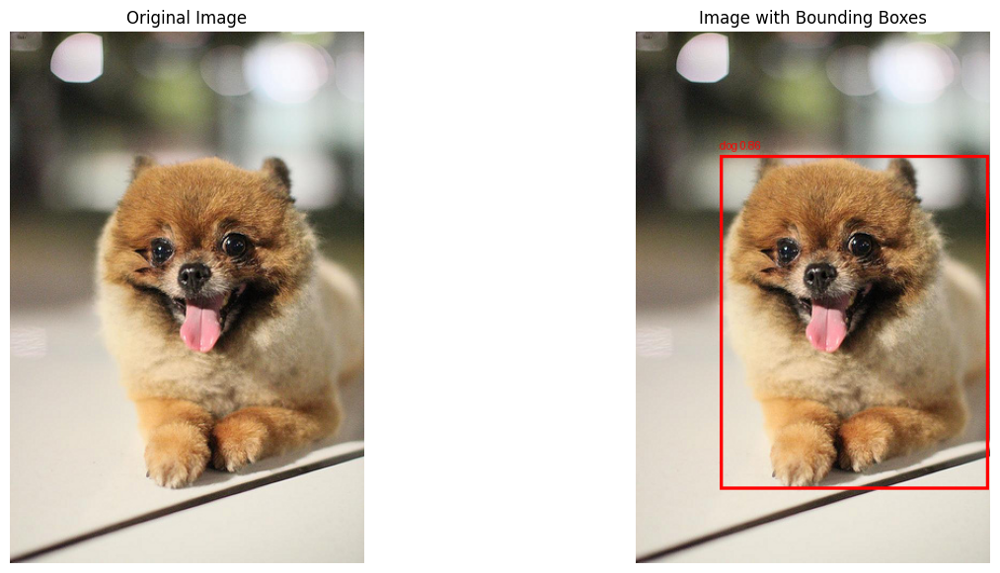

Processing image: /content/oxford/english_cocker_spaniel/english_cocker_spaniel_31.jpg


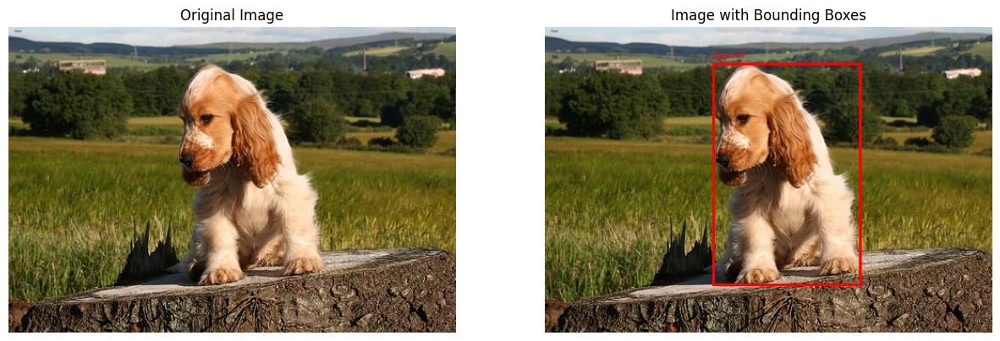

Processing image: /content/oxford/newfoundland/newfoundland_96.jpg


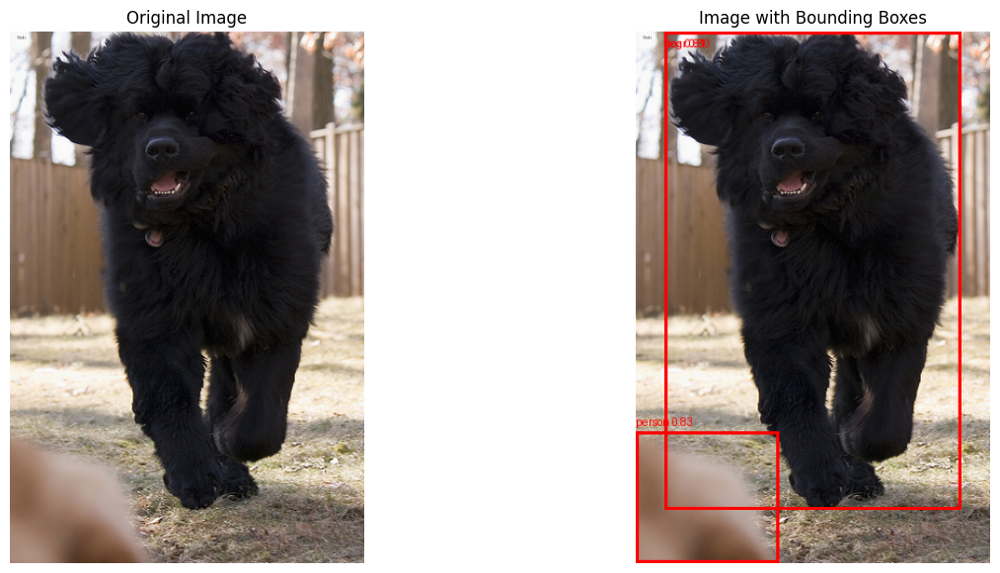

Processing image: /content/oxford/Siamese/Siamese_161.jpg


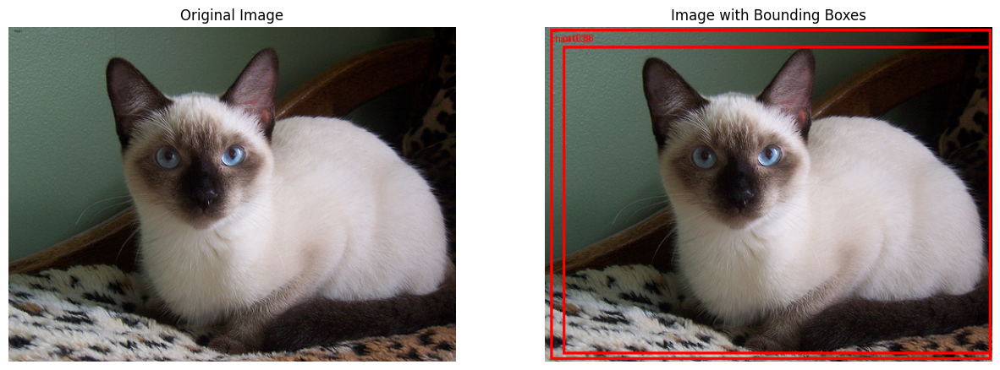

Processing image: /content/oxford/Birman/Birman_37.jpg


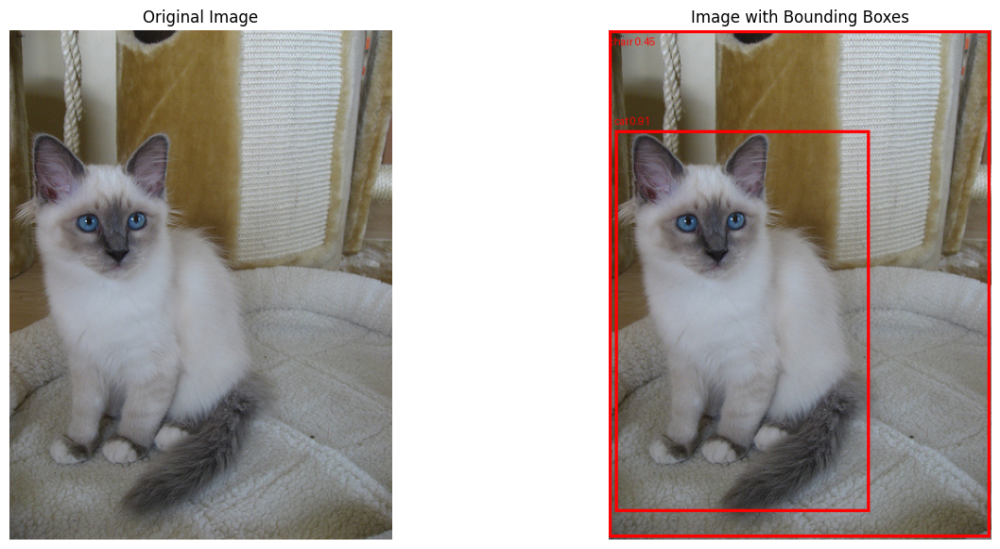

Processing image: /content/oxford/keeshond/keeshond_107.jpg


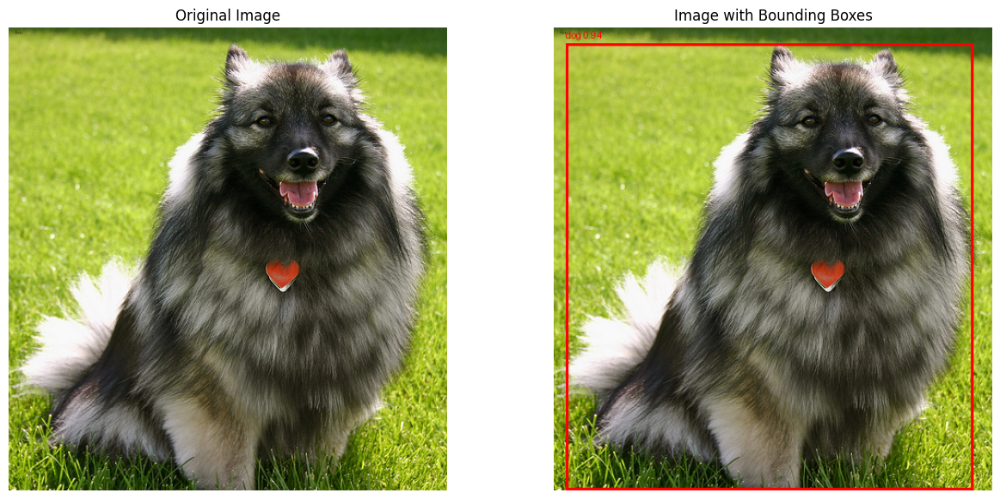

Processing image: /content/oxford/Russian_Blue/Russian_Blue_232.jpg


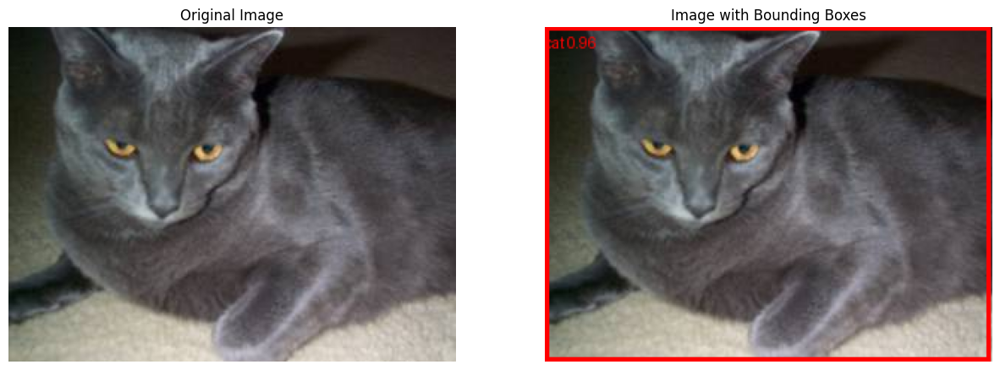

Processing image: /content/oxford/Siamese/Siamese_67.jpg


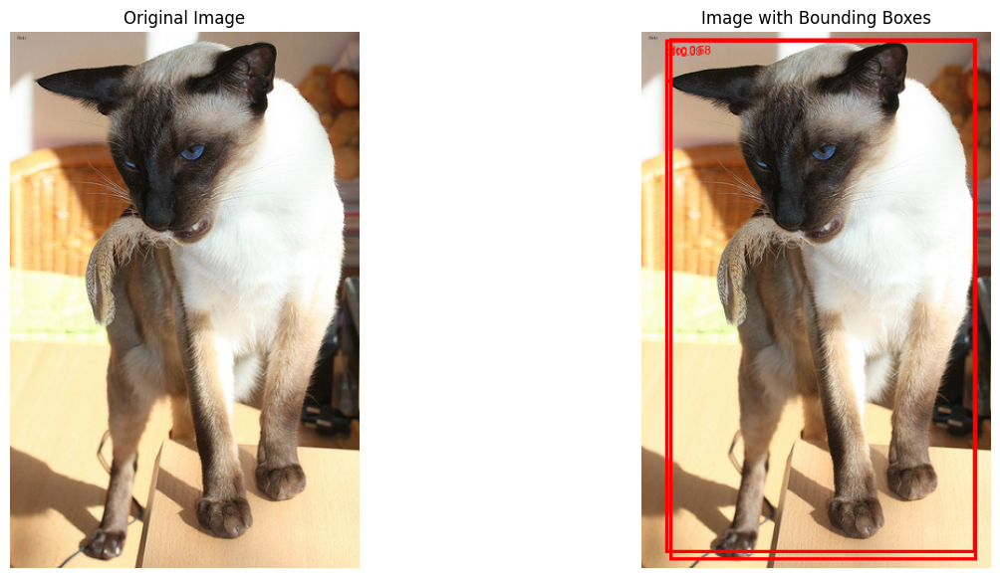

Processing image: /content/oxford/chihuahua/chihuahua_146.jpg


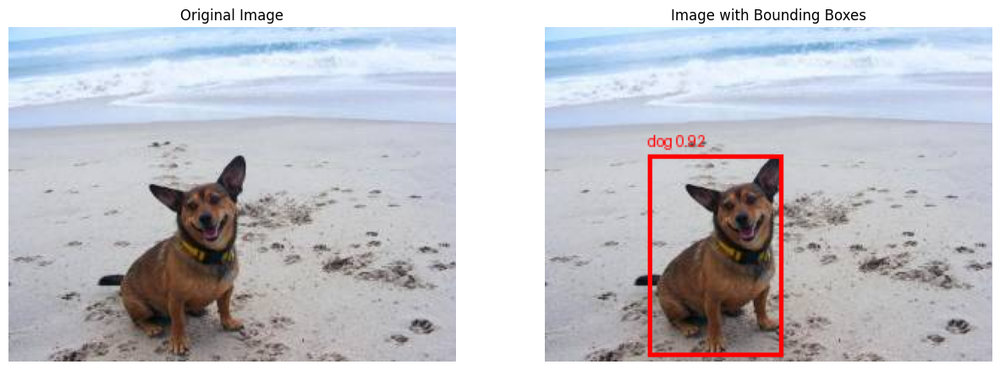

In [ ]:
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import numpy as np
import random
# Ensure 'model' is loaded and 'paths' is populated
# model = yolo_funcs.get_model() # This should have been run in cell FAz98d4k78HR
# paths = glob.glob('/content/oxford/**/*') # This should have been run in cell 8_0EaFz-ei_J

for p in random.sample(paths, 50):
    # Select the first image from the 'paths' list for demonstration
    image_path = p
    print(f"Processing image: {image_path}")

    # Load the original image
    original_image = Image.open(image_path).convert("RGB")

    # Perform YOLO inference directly using the 'model' object
    # We set a confidence threshold (conf=0.25) to filter detections
    results = model.predict(image_path, conf=0.25, verbose=False) # verbose=False to suppress verbose output

    # Extract bounding box data and labels
    boxes_data = []
    for r in results:
        for box in r.boxes:
            # Get coordinates, confidence, and class ID
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().astype(int)
            conf = box.conf[0].cpu().numpy()
            cls = int(box.cls[0].cpu().numpy())

            # Get class name from model.names (available after model loading)
            label = model.names[cls]

            boxes_data.append({
                'box': [x1, y1, x2, y2],
                'label': f'{label} {conf:.2f}' # Format label with confidence score
            })

    # Create a copy of the original image to draw on
    annotated_image = original_image.copy()
    draw = ImageDraw.Draw(annotated_image)

    # Draw bounding boxes and labels
    for bbox_info in boxes_data:
        box = bbox_info['box']
        label = bbox_info['label']

        x1, y1, x2, y2 = box

        # Draw rectangle
        draw.rectangle([x1, y1, x2, y2], outline="red", width=3)

        # Draw label (adjust position to be above the box)
        # Using a simple font if available, otherwise default will be used
        try:
            # Attempt to use a default font for better text rendering
            from PIL import ImageFont
            font = ImageFont.load_default(size=20) # You can try 'arial.ttf' if available: ImageFont.truetype("arial.ttf", 20)
            text_width, text_height = draw.textsize(label, font=font)
            text_x = x1
            text_y = y1 - text_height - 5 # Position above the box with a small margin
            if text_y < 0: # Ensure label is not off the top of the image
                text_y = y1 + 5 # Place below if not enough space above
            draw.text((text_x, text_y), label, fill="red", font=font)
        except Exception as e:
            print(f"Warning: Could not load default font for label drawing ({e}). Drawing without specified font.")
            draw.text((x1, y1 - 15 if y1 - 15 > 0 else y1 + 5), label, fill="red")

    # Display images side by side
    plt.figure(figsize=(15, 7))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(annotated_image)
    plt.title("Image with Bounding Boxes")
    plt.axis("off")

    plt.show()
